<a href="https://colab.research.google.com/github/Olivia-SMY/3d-flow-matching-demo/blob/main/Flow_matching_model_for_3D_point_cloud_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:

import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


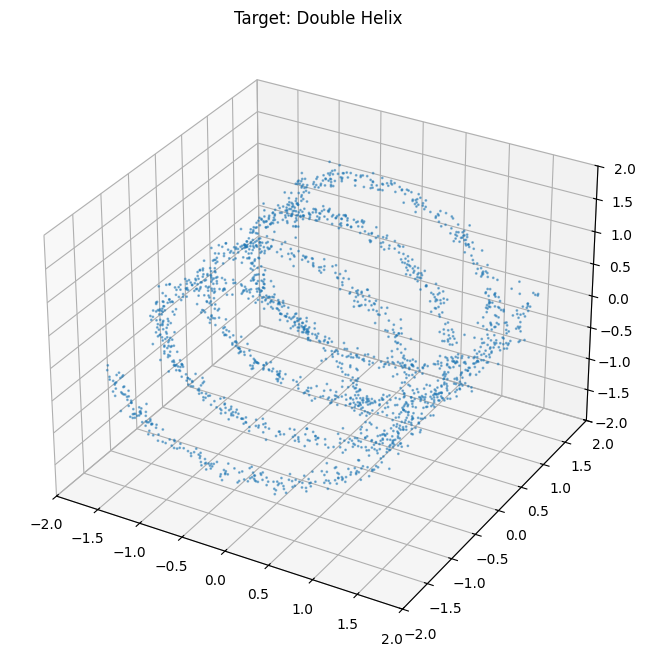

In [24]:

def get_double_helix_data(n_samples=2048):

    n = n_samples // 2
    z = np.random.rand(n) * 4 * np.pi - 2 * np.pi # [-2pi, 2pi]
    r = 1.0

    x1 = r * np.cos(z)
    y1 = r * np.sin(z)
    data1 = np.stack([x1, y1, z], axis=1)

    x2 = r * np.cos(z + np.pi)
    y2 = r * np.sin(z + np.pi)
    data2 = np.stack([x2, y2, z], axis=1)

    data = np.concatenate([data1, data2], axis=0)

    data += np.random.randn(*data.shape) * 0.05

    data = (data - data.mean(axis=0)) / data.std(axis=0)

    return torch.tensor(data, dtype=torch.float32).to(device)


target_data = get_double_helix_data()
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(target_data[:, 0].cpu(), target_data[:, 2].cpu(), target_data[:, 1].cpu(), s=1, alpha=0.5)
ax.set_title("Target: Double Helix")
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)
ax.set_zlim(-2, 2)
plt.show()

In [18]:
class VectorFieldNet(nn.Module):
    def __init__(self):
        super().__init__()

        self.net = nn.Sequential(
            nn.Linear(4, 256),
            nn.Softplus(),
            nn.Linear(256, 512),
            nn.Softplus(),
            nn.Linear(512, 256),
            nn.Softplus(),
            nn.Linear(256, 3)
        )

    def forward(self, x, t):

        t_emb = t.view(-1, 1).expand(x.shape[0], 1)
        xt = torch.cat([x, t_emb], dim=-1)
        return self.net(xt)

model = VectorFieldNet().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
print("Model initialized")

Model initialized!


Start Training...
Step 0: Loss = 2.123855
Step 1000: Loss = 1.441339
Step 2000: Loss = 1.403925
Step 3000: Loss = 1.457322
Step 4000: Loss = 1.426253
Step 5000: Loss = 1.420418
Step 6000: Loss = 1.432364
Step 7000: Loss = 1.415549
Step 8000: Loss = 1.393488
Step 9000: Loss = 1.359718
Step 10000: Loss = 1.371405
Step 11000: Loss = 1.343219
Step 12000: Loss = 1.372369
Step 13000: Loss = 1.344889
Step 14000: Loss = 1.329776
Step 15000: Loss = 1.369310
Step 16000: Loss = 1.407661
Step 17000: Loss = 1.312978
Step 18000: Loss = 1.378561
Step 19000: Loss = 1.372162
Step 20000: Loss = 1.341486
Step 21000: Loss = 1.379500
Step 22000: Loss = 1.387268
Step 23000: Loss = 1.394527
Step 24000: Loss = 1.371410
Step 25000: Loss = 1.374266
Step 26000: Loss = 1.371783
Step 27000: Loss = 1.336308
Step 28000: Loss = 1.342119
Step 29000: Loss = 1.342867
Step 30000: Loss = 1.371516
Step 31000: Loss = 1.371237
Step 32000: Loss = 1.362225
Step 33000: Loss = 1.299684
Step 34000: Loss = 1.317181
Step 35000: Los

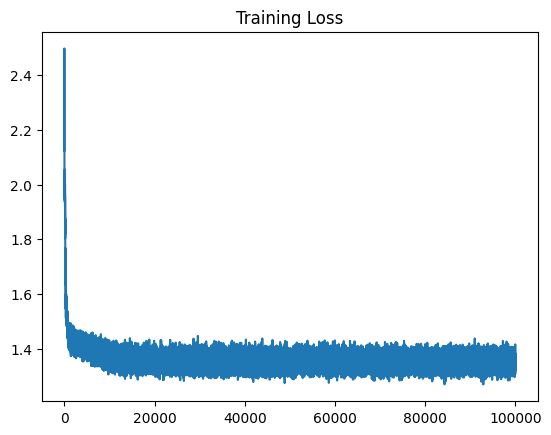

In [19]:
steps = 100000
batch_size = 4096
loss_history = []

print("Start Training")

for step in range(steps):
    optimizer.zero_grad()

    x1 = x1 = get_double_helix_data(batch_size)
    x0 = torch.randn_like(x1)
    t = torch.rand(batch_size, 1).to(device)
    x_t = (1 - t) * x0 + t * x1
    target_v = x1 - x0
    pred_v = model(x_t, t)
    loss = torch.mean((pred_v - target_v)**2)

    loss.backward()
    optimizer.step()

    loss_history.append(loss.item())

    if step % 1000 == 0:
        print(f"Step {step}: Loss = {loss.item():.6f}")

plt.plot(loss_history)
plt.title("Training Loss")
plt.show()

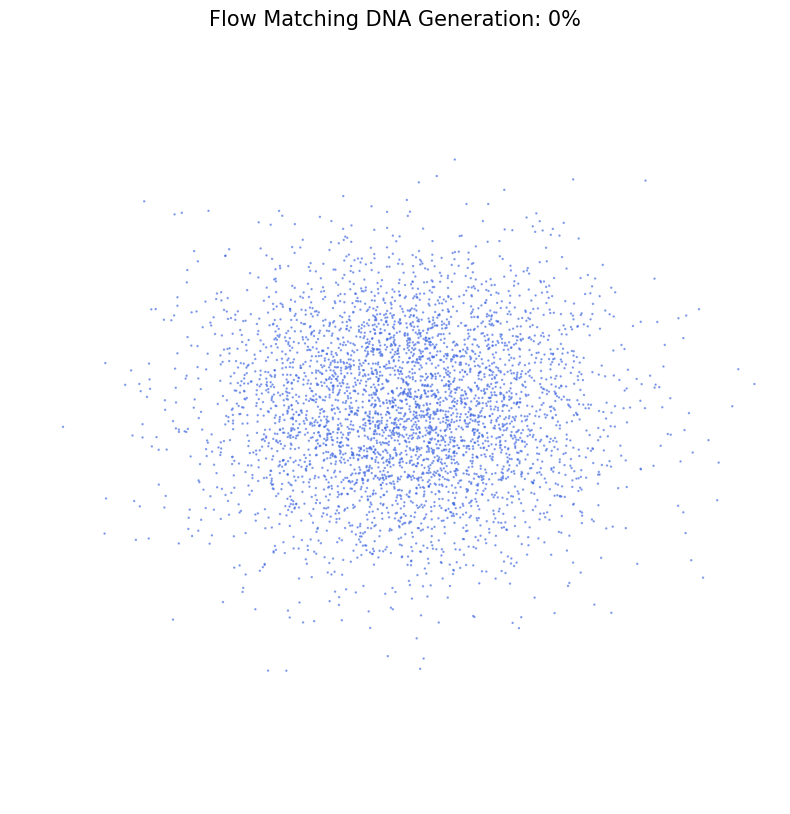

In [20]:
@torch.no_grad()
def sample_ode(model, n_points=4096, n_steps=100):
    x = torch.randn(n_points, 3).to(device)
    traj = [x.cpu().numpy()]
    dt = 1.0 / n_steps
    for i in range(n_steps):
        t = torch.ones(n_points, 1).to(device) * (i / n_steps)
        v = model(x, t)
        x = x + v * dt
        traj.append(x.cpu().numpy())
    return np.array(traj)

trajectory = sample_ode(model)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

ax.set_axis_off()

def update(frame):
    ax.clear()
    ax.set_axis_off()
    data = trajectory[frame]

    ax.scatter(data[:, 0], data[:, 2], data[:, 1], s=0.5, alpha=0.6, c='royalblue')

    ax.set_xlim(-2.5, 2.5)
    ax.set_ylim(-2.5, 2.5)
    ax.set_zlim(-2.5, 2.5)

    ax.view_init(elev=20, azim=frame)

    ax.set_title(f"Flow Matching DNA Generation: {frame}%", fontsize=15)

ani = animation.FuncAnimation(fig, update, frames=len(trajectory), interval=50)
ani.save('dna_flow_matching.gif', writer='pillow', fps=30)
HTML(ani.to_jshtml())

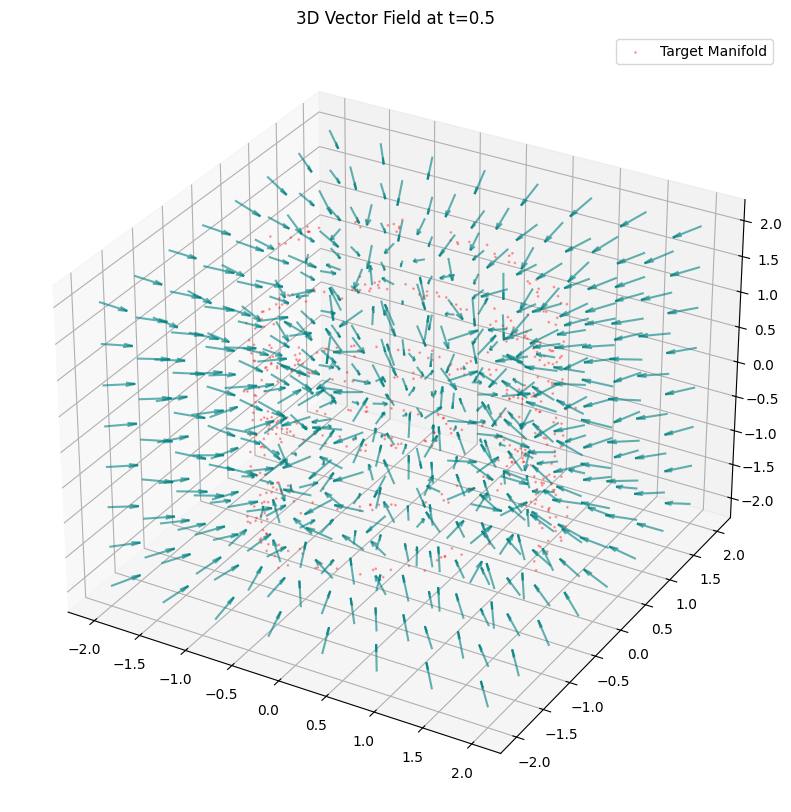

In [23]:
def plot_3d_vector_field(model, t_value=0.5):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    n = 8
    x = np.linspace(-2, 2, n)
    y = np.linspace(-2, 2, n)
    z = np.linspace(-2, 2, n)
    X, Y, Z = np.meshgrid(x, y, z)

    points = np.stack([X.flatten(), Y.flatten(), Z.flatten()], axis=1)
    points_tensor = torch.tensor(points, dtype=torch.float32).to(device)
    t_tensor = torch.ones(points_tensor.shape[0], 1).to(device) * t_value

    with torch.no_grad():
        v = model(points_tensor, t_tensor).cpu().numpy()

    U = v[:, 0]
    V = v[:, 1]
    W = v[:, 2]

    ax.quiver(points[:,0], points[:,1], points[:,2], U, V, W, length=0.3, normalize=True, color='teal', alpha=0.6)

    target_data = get_double_helix_data(500).cpu().numpy()
    ax.scatter(target_data[:,0], target_data[:,1], target_data[:,2], s=1, c='red', alpha=0.3, label='Target Manifold')

    ax.set_title(f"3D Vector Field at t={t_value}")
    plt.legend()
    plt.show()

plot_3d_vector_field(model)